# Multi-scale modeling

[Tutorial 1.3](../1.%20neuron%20models/1.3%20Generation.ipynb) covered how to generate biophysically detailed compartmental models of a neuron. 
[Tutorial 2.1](../2.%20network%20models/2.1%20Anatomical%20embedding.ipynb) and [Tutorial 2.2](../2.%20network%20models/2.2%20Network%20activity.ipynb) covered how to embed neuron models into a network reconstruction, and how to generate synaptic activity that reflects an in vivo condition.

This tutorial will show how to combine the two models into a single multi-scale simlation.

In [1]:
from pathlib import Path
tutorial_output_dir = f"{Path.home()}/isf_tutorial_output"  # <-- Change this to your desired output directory

In [2]:
import Interface as I
from getting_started import getting_started_dir
db = I.DataBase(tutorial_output_dir)['network_modeling']

if not 'biophysical_constraints' in db.keys():
    cell_parameter_file = I.os.path.join(
        getting_started_dir, 
        'example_data',
        'biophysical_constraints', 
        '86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')
    I.shutil.copy(cell_parameter_file, db.create_managed_folder('biophysical_constraints'))
cell_parameter_file = db['biophysical_constraints'].join('86_CDK_20041214_BAC_run5_soma_Hay2013_C2center_apic_rec.param')

[INFO] ISF: Current version: heads/develop
[INFO] ISF: Current pid: 50493
[INFO] ISF: Loading mechanisms:


--No graphics will be displayed.





[INFO] ISF: Loaded modules with __version__ attribute are:
IPython: 8.12.2, Interface: heads/develop, PIL: 10.4.0, _brotli: 1.0.9, _csv: 1.0, _ctypes: 1.1.0, _curses: b'2.2', _decimal: 1.70, argparse: 1.1, backcall: 0.2.0, blosc: 1.11.1, bluepyopt: 1.9.126, brotli: 1.0.9, certifi: 2024.08.30, cffi: 1.17.0, charset_normalizer: 3.4.0, click: 7.1.2, cloudpickle: 3.1.0, colorama: 0.4.6, comm: 0.2.2, csv: 1.0, ctypes: 1.1.0, cycler: 0.12.1, cytoolz: 0.12.3, dash: 2.18.2, dask: 2.30.0, dateutil: 2.9.0, deap: 1.4, debugpy: 1.8.5, decimal: 1.70, decorator: 5.1.1, defusedxml: 0.7.1, distributed: 2.30.0, distutils: 3.8.20, django: 1.8.19, entrypoints: 0.4, executing: 2.1.0, fasteners: 0.17.3, flask: 1.1.4, fsspec: 2024.10.0, future: 1.0.0, greenlet: 3.1.1, idna: 3.10, ipaddress: 1.0, ipykernel: 6.29.5, ipywidgets: 8.1.5, isf_pandas_msgpack: 0.2.2, itsdangerous: 1.1.0, jedi: 0.19.1, jinja2: 2.11.3, joblib: 1.4.2, json: 2.0.9, jupyter_client: 7.3.4, jupyter_core: 5.7.2, kiwisolver: 1.4.5, loggi

## Simulating synaptic activity

The previous tutorials on network modeling provided us with a functional network that mimics the *in vivo* condition of the passive touch of a whisker.

Here, we will simulate one single trail for each whisker stimulus and save the result in the database under the `simrun` key.

In [3]:
delayeds = []

# Delete previous results, if they exist
if 'simrun' in db.keys(): 
    del db['simrun']
    
# Create new folder for results
db.create_managed_folder('simrun')
for whisker in ['B1', 'B2', 'B3', 'C1', 'C2', 'C3', 'D1', 'D2', 'D3']:
    network_file = db['network_param'].join('{}_stim.param'.format(whisker))
    dir_prefix = db['simrun'].join('stim_{}'.format(whisker))
    
    nSweeps = 1 # number of consecutive simulations per process
    nprocs = 1 # number of processes simulating that task in parallel    
    tStop = 300 # stop the simulation at 300ms
    
    d = I.simrun_run_new_simulations(
        cell_parameter_file, # defined in the above cell
        network_file, 
        dirPrefix = dir_prefix,
        nSweeps = nSweeps, 
        nprocs = nprocs, 
        tStop = tStop, 
        silent = False)
    delayeds.append(d)

`I.simrun_run_new_simulations` returns `dask.delayed` objects. These describe *how* the computation can be run, but it is not computed yet. We send it to our distributed cluster for that:

In [4]:
client = I.get_client()
client

Client Scheduler: tcp://10.100.2.206:38786 Dashboard: http://10.100.2.206:38787/status,Cluster Workers: 40 Cores: 40 Memory: 4.00 TB


In [5]:
futures = client.compute(delayeds)

You can inspect the progress of the simulation at the dask `Dashboard`, linked above.

After this is complete, the "simrun" folder in the DataBase contains the simulation results

In [6]:
db['simrun'].listdir()

['Loader.json', 'metadata.json']

## Analyzing the results

here, we use [DataBase](../../../data_base/__init__.py) to parse our simulation results to high-performance file formats. For more info, refer to the [database simrun initializer](../../../data_base/isf_data_base/db_initializers/load_simrun_general.py).
These initialize simulation results in a database for convenient access to the data using the widely used pandas and dask libraries. It also converts the data to an optimized binary format: msgpack. This gives the following advantages:
  - the `msgpack` format is extremely fast
  - `msgpack` allows for `blosc` compression, reducing space on hard drive (<25% of original data)
  - cell activation data is categorized i.e. repeated values are replaced by an integer

In [8]:
I.db_init_simrun_general.init(
    db,
    db['simrun'],
    client=client
)

Now, the following keys are set:

| Key | Description | Type |
|---|---|---|
| `synapse_activation` |activation of synapses for each simulationtrail | `dask.DataFrame` |
|`cell_activation`| activation of presynaptic cells for each simulationtrail| `dask.DataFrame`
|`voltage_traces`| soma voltage traces| `dask.DataFrame`
|`spike_times`| spike times| `pandas.DataFrame`
|`dendritic_recordings`| voltage traces on the dendrite as specified in the cell parameter file| `DataBase` containing a separate `dask.DataFrame` for every recording location
|`metadata`| original filenames| `pandas.DataFrame`
|`parameterfiles`| mapping between simulation trial and used parameter files| `pandas.DataFrame`
|`parameterfiles_cell_folder`| folder containing the cell parameter files| `ManagedFolder`
|`parameterfiles_network_folder`| folder containing the network parameterfiles| `ManagedFolder`
|`sim_trail_index`| all simulation trials| `pandas.Series`
|`simresult_path`| original path from which the simulation has been loaded| `str`

Let's have a look at the synapse activation data frame:

In [9]:
db['synapse_activation']

,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=9,,,,,,,,,,,,,
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B2/results/20250327-1823_seed1559350411_pid36745/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20250327-1823_seed622584983_pid36112/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20250327-1823_seed622584983_pid36112/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This is a dask dataframe object. Instead of loading the data fully, it is a pointer to the actual data which is stored in the database using the parquet binary format. The data is split up into chunks of reasonable file size. 

Only when actual computations need to be done, are the values of the data loaded. Until then, it will only provide relevant metadata. Let's explicitly load a small fractin of the data to have a look:

In [10]:
head = db['synapse_activation'].head(2)
head

,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trial_index,,,,,,,,,,,,,
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_B1,3,1441.802898,46,19,ApicalDendrite,99.623881,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_B2,6,1366.422297,78,31,ApicalDendrite,253.943241,NaN,NaN,NaN,NaN,NaN,NaN


We can select data using the index:

In [11]:
some_index = db['synapse_activation'].compute().index[0]
db['synapse_activation'].loc[some_index]

,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=1,,,,,,,,,,,,,
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This returns a dask dataframe again; the query is not computed yet. To do this, call compute:

In [12]:
# this prints out a table containing all synapse activations during the specified trail
db['synapse_activation'].loc[some_index].compute()

,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trial_index,,,,,,,,,,,,,
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_B1,3,1441.802898,46,19,ApicalDendrite,99.623881,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_B2,6,1366.422297,78,31,ApicalDendrite,253.943241,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_B3,1,1227.108477,40,169,ApicalDendrite,137.176301,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_C1,2,1484.417691,57,87,ApicalDendrite,279.390388,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,L1_C1,3,1439.699450,57,68,ApicalDendrite,279.390388,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,VPM_C2,240,18.796248,94,23,Dendrite,110.169047,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,VPM_C2,252,53.605914,85,72,Dendrite,259.144935,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20250327-1823_seed4095671765_pid36080/000000,VPM_C2,254,299.458583,33,46,ApicalDendrite,259.144935,NaN,NaN,NaN,NaN,NaN,NaN


### Analytics

What is the average distance of synapses from the soma by celltype?

In [13]:
# load dask dataframe
sa = db['synapse_activation']
# assign a new column: the celltype is the first part of the synapse_type column
sa['celltype'] = sa.map_partitions(lambda x: x.synapse_type.str.split('_').str[0])
# groupb by this value, compute the mean soma distance in each group, compute the result on the cluster
sa.groupby('celltype').apply(lambda x: x.soma_distance.mean()).compute(scheduler=client)

[WARNING] py: `meta` is not specified, inferred from partial data. Please provide `meta` if the result is unexpected.
  Before: .apply(func)
  After:  .apply(func, meta={'x': 'f8', 'y': 'f8'}) for dataframe result
  or:     .apply(func, meta=('x', 'f8'))            for series result


celltype
L56Trans      167.630698
L1           1397.626394
L4py          276.866549
L6ct          174.283450
SymLocal1    1161.161267
SymLocal6     151.661303
L4sp          505.903436
L45Sym        201.920454
L5tt          234.639963
SymLocal4     120.095730
L23Trans      891.155617
L45Peak       361.240906
L4ss          410.789081
L2            753.778724
SymLocal3     218.974242
SymLocal5     154.413647
VPM           266.467875
L34           498.396412
L5st          786.884596
L6cc          322.750214
L6ccinv       227.546271
SymLocal2     676.986399
dtype: float64

### Visualization

It is easy to create an animation of a simulation trail from the database:

In [14]:
cell = I.simrun_simtrial_to_cell_object(db, some_index)

#### 2D animation of membrane voltage


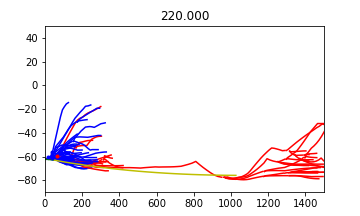
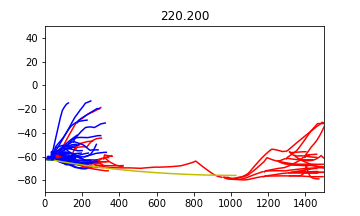
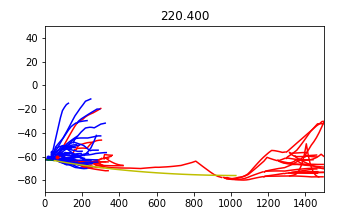
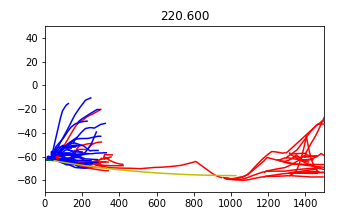
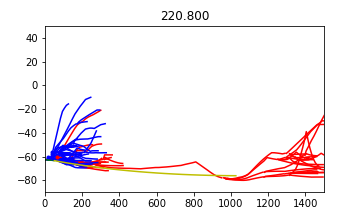
...
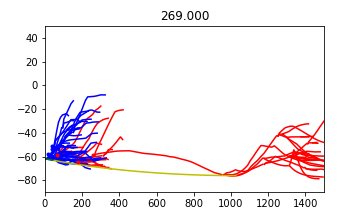
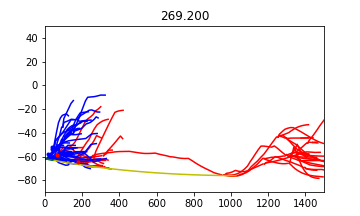
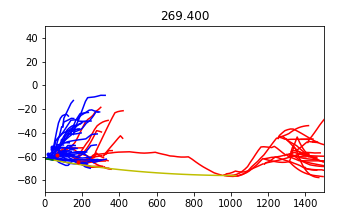
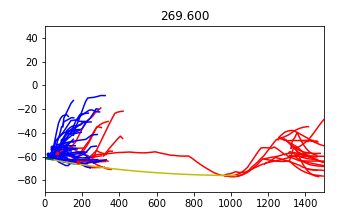
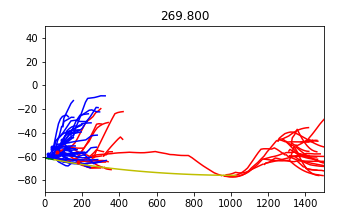

In [15]:
if not 'D3_stim_animation' in db.keys():
    I.cell_to_animation(
        cell,
        xlim = [0,1500],
        ylim = [-90, 50],
        tstart = 245-25,
        tend = 245+25,
        tstep = 0.2,
        outdir = db.create_managed_folder('D3_stim_animation'))
I.display_animation(db['D3_stim_animation'].join('*', '*png'), embedded = True)

#### 3D animation of the membrane voltage and synapse activations


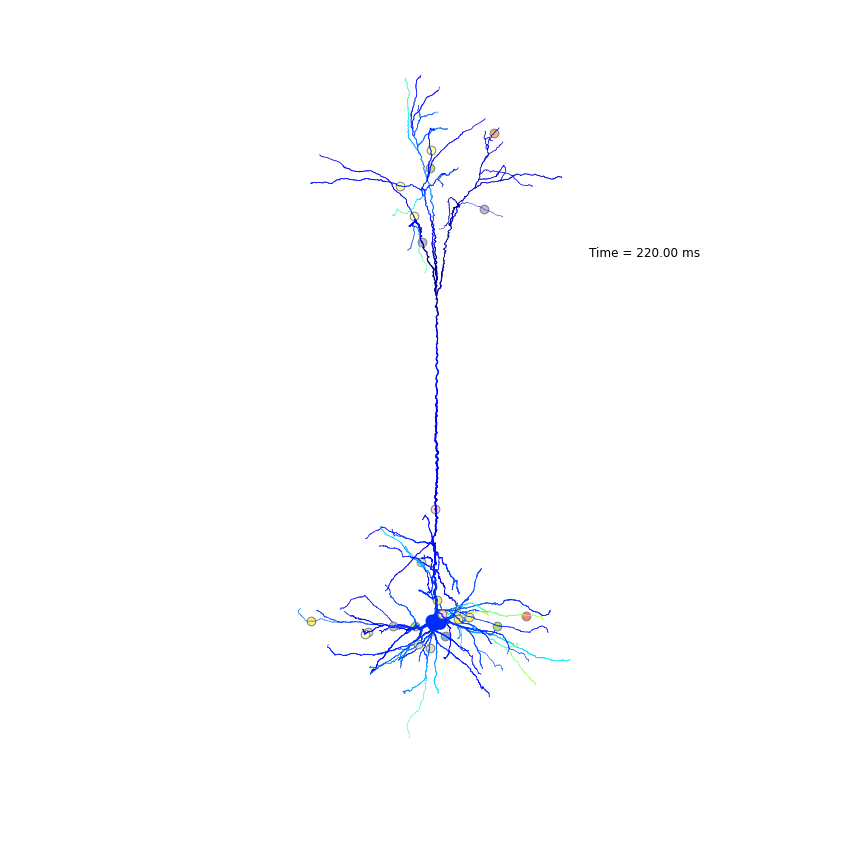
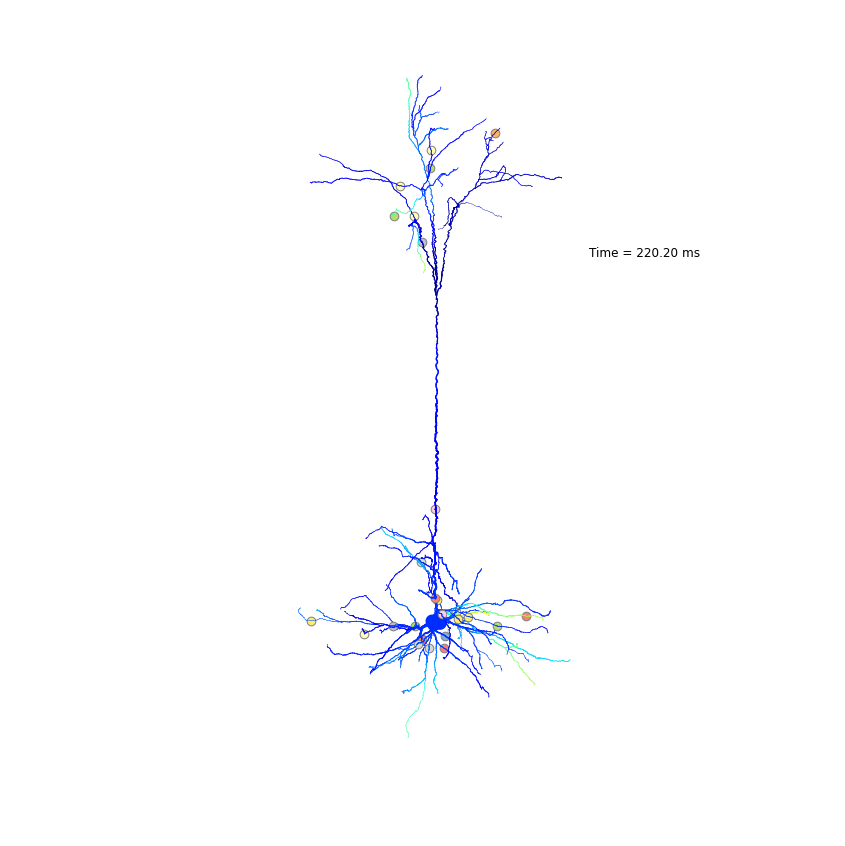
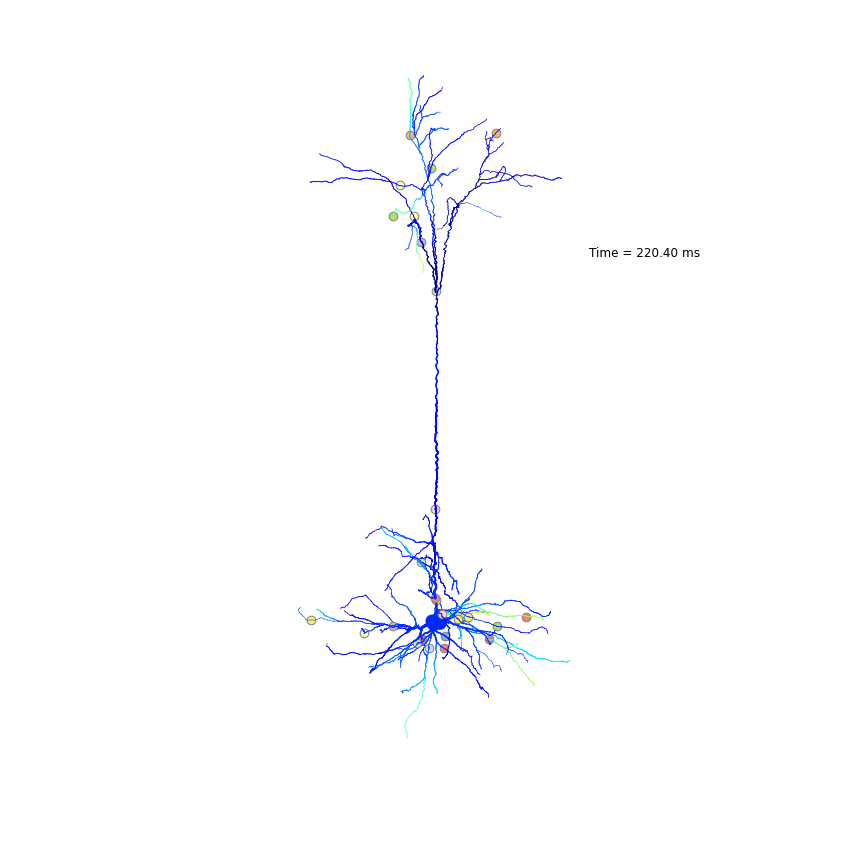
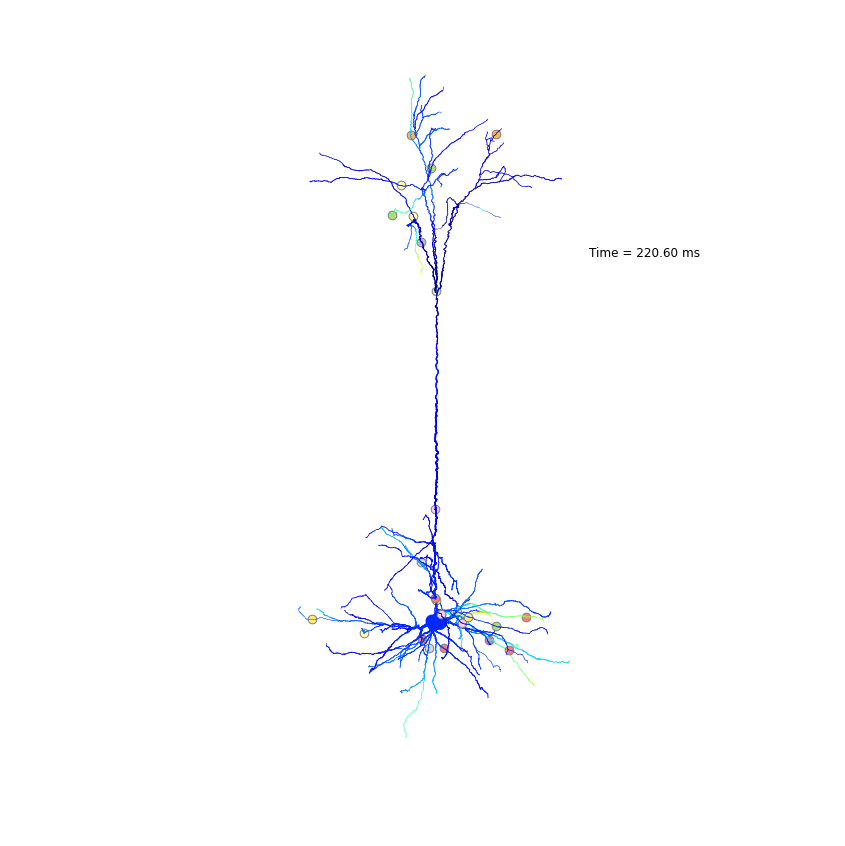
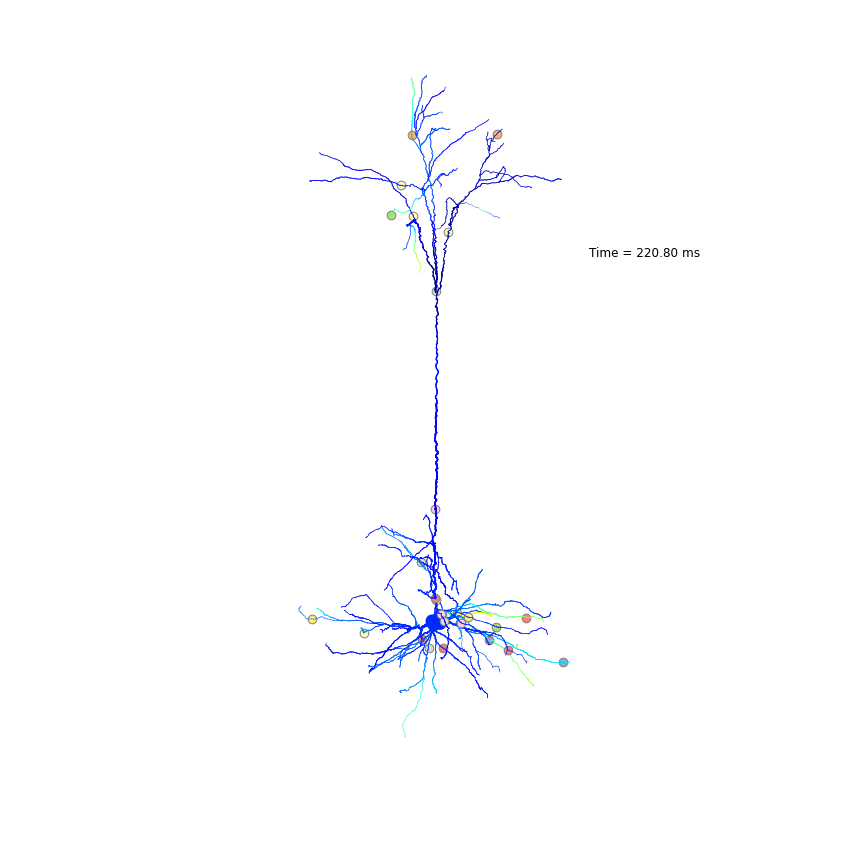
...
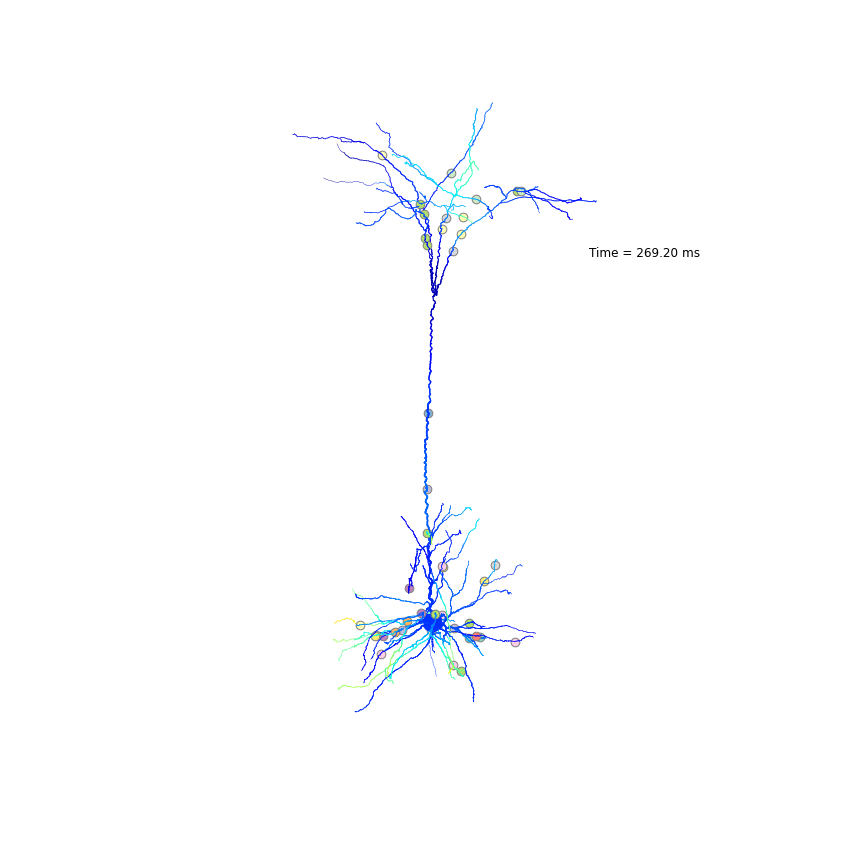
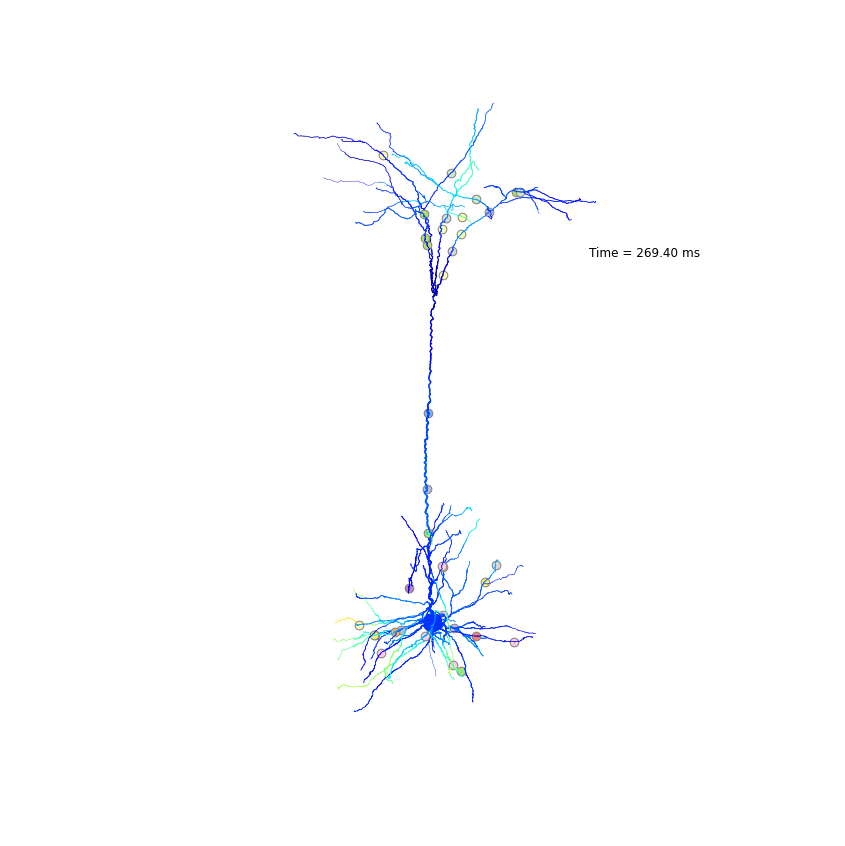
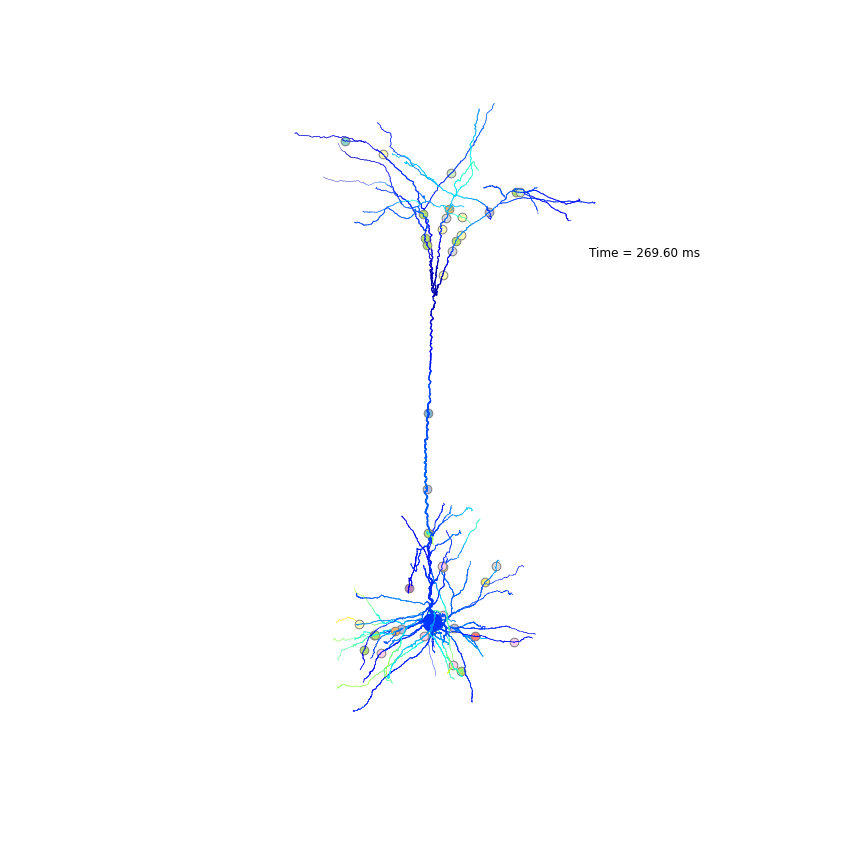
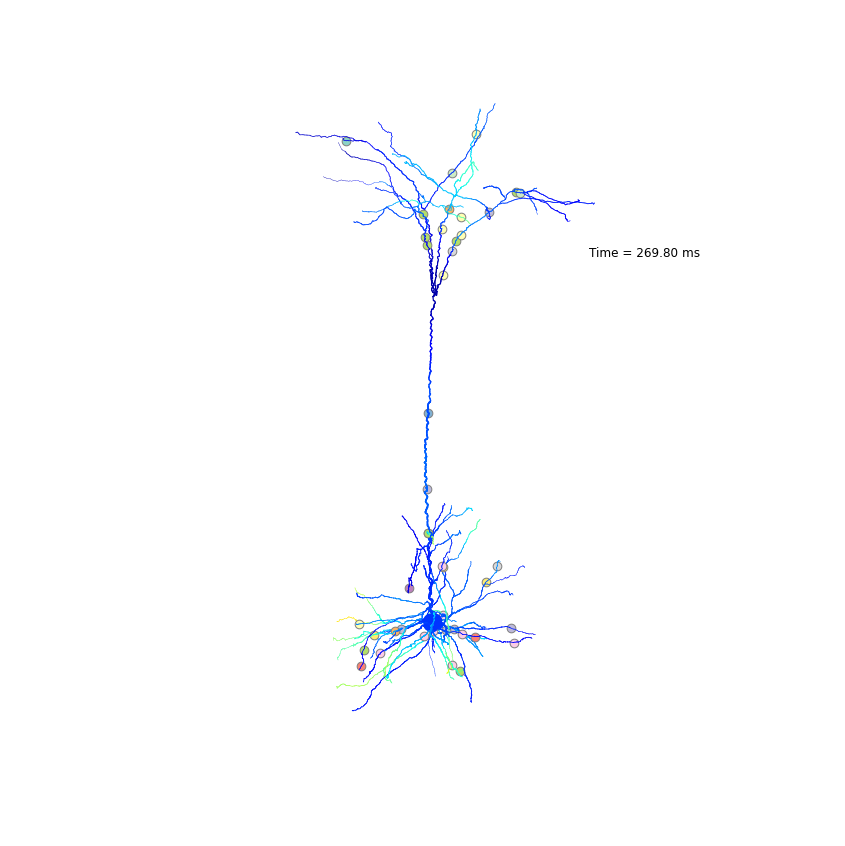
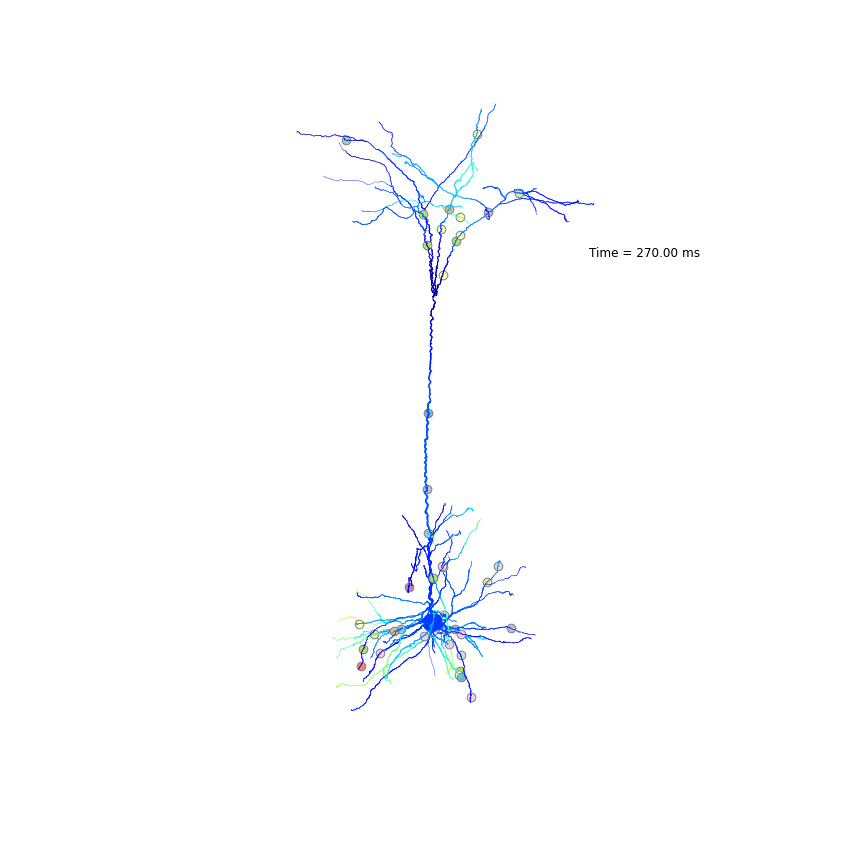

In [16]:
from visualize.cell_morphology_visualizer import CellMorphologyVisualizer

# # To remake the visualization, uncomment this code
# if I.os.path.exists(db._basedir/'D3_stim_animation_3d'):
#     I.shutil.rmtree(db._basedir/'D3_stim_animation_3d')

images_path = str(db._basedir/'D3_stim_animation_3d')

cmv = CellMorphologyVisualizer(
    cell,
    t_start=245-25, 
    t_stop=245+25, 
    t_step=0.2
    )

cell_population = cell.synapses.keys()
cell_population_colors = {
    synapse: I.plt.cm.Set3(i/len(cell_population)) 
    for i, synapse in enumerate(cell_population)}
cell_population_colors['inactive'] = "#f0f0f0"
cmv.population_to_color_dict = cell_population_colors

cmv.animation(
    images_path=images_path, 
    color="voltage",
    show_synapses=True,
    client=I.get_client(), 
)

#### 3D visualization of the membrane voltage and presynaptic cell activations

You can even visualize the soma locations of the active presynaptic cells. 

As this requires 3D rendering, we are going to step out of python to visualize this. You can write out the postsynaptic cell and presynaptic locations as `.vtk` files: free, open-source and standardized. These can in principle be visualized in Python, but the rendering setup is a bit tedious. You can also use any rendering program that supports `.vtk`. We recommend Paraview.

In [17]:
if not 'synapse_activation_vtk' in db.keys():
    db.create_managed_folder('synapse_activation_vtk')
db.ls()

Located at /gpfs/soma_fs/home/meulemeester/isf_tutorial_output/network_modeling/db
db
├── cell_activation
├── voltage_traces
├── simresult_path
├── metadata
├── anatomical_constraints
├── parameterfiles
├── synapse_activation_vtk
├── filelist
├── spike_times
├── D3_stim_animation
├── simrun
├── dendritic_spike_times
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7_-30.0
├── dendritic_recordings
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7
├── synapse_activation
├── parameterfiles_network_folder
├── biophysical_constraints
├── D3_stim_animation_3d
├── sim_trial_index
... (2 more)


Let's map the presynaptic cells to their corresponding location. The activation of presynaptic cells, including their celltype, is given in the DataBase key `"cell_acativation"`. Their locations are saved in the `"anatomical_constraints"` key.

In [18]:
from simrun.utils import get_fraction_of_landmarkAscii_dir
soma_location_pdf = get_fraction_of_landmarkAscii_dir(1, db._basedir/'anatomical_constraints'/'presynaptic_somata')
ca = db['cell_activation'].loc[some_index].compute()
ca['celltype'] = [e.split("_")[0] for e in ca['presynaptic_cell_type']]
soma_location_pdf['celltype'] = [e.split("_")[-1] for e in soma_location_pdf['label']]

soma_location_pdf

,positions,label,celltype
0,"(134.2679, -55.303, 660.2123)",presynaptic_somata_L1,L1
1,"(-38.03819, 601.873, 582.2783)",presynaptic_somata_L1,L1
2,"(-587.8605, 258.4359, 594.6266)",presynaptic_somata_L1,L1
3,"(162.8093, 525.512, 555.7564)",presynaptic_somata_L1,L1
4,"(-187.7814, 483.681, 625.4604)",presynaptic_somata_L1,L1
...,...,...,...
19699,"(2359.15, -1226.54, 85.9478)",presynaptic_somata_VPM,VPM
19700,"(2350.86, -1421.18, 430.14)",presynaptic_somata_VPM,VPM
19701,"(2307.96, -1438.63, 380.614)",presynaptic_somata_VPM,VPM
19702,"(2395.65, -1340.0, 210.765)",presynaptic_somata_VPM,VPM


In [19]:
outdir = I.os.path.join(db.basedir, 'synapse_activation_vtk')

cmv_unaligned = CellMorphologyVisualizer(
    cell, 
    align_trunk=False,
    t_start=245-25, 
    t_stop=245+25,
    t_step=0.2,
    )

cmv_unaligned.write_vtk_frames(
    I.os.path.join(outdir, 'cell_D3_stim.vtk'),
    color="voltage",
    client=I.get_client()
)

In [20]:
from visualize.vtk import save_cells_landmark_files_vtk

outdir = db._basedir/'synapse_activation_vtk'
I.logger.setLevel("INFO")  # some more output
a = save_cells_landmark_files_vtk(
    ca,
    soma_location_pdf,
    times_to_show=cmv_unaligned.times_to_show,  # be sure the times are aligned
    outdir=outdir,
    tspan=5,  # amount of time the synapse stays visible after it has been activated
    set_index = ['celltype', 'cell_ID'])

[INFO] vtk: Celltype nr mapper: {'L1': 0, 'L23Trans': 1, 'L2': 2, 'L34': 3, 'L45Peak': 4, 'L45Sym': 5, 'L4py': 6, 'L4sp': 7, 'L4ss': 8, 'L56Trans': 9, 'L5st': 10, 'L5tt': 11, 'L6cc': 12, 'L6ccinv': 13, 'L6ct': 14, 'SymLocal1': 15, 'SymLocal2': 16, 'SymLocal3': 17, 'SymLocal4': 18, 'SymLocal5': 19, 'SymLocal6': 20, 'VPM': 21}
[WARNING] vtk: No celltypes passed. Using all celltypes in the dataset.


You can now inspect these files in a `.vtk` compatible program. The result should look like this:

![](../../../docs/_static/_images/frame.0000.png)